In [1]:
# Iman Wahle, Jenna Kahn
# Created March 9, 2021
# This notebook demonstrates how to compare clustering methods on multiple datasets

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
import compare
import warnings
from tensorflow.keras.datasets import mnist
from sklearn.manifold import TSNE

In [3]:
# paths
base_path = '/Users/imanwahle/Desktop/cfl/cfl/cluster_methods/compare_methods'
DATA_PATH = os.path.join(base_path, 'data')
RESULTS_PATH = os.path.join(base_path, 'results')
FIG_PATH = os.path.join(base_path, 'figures')

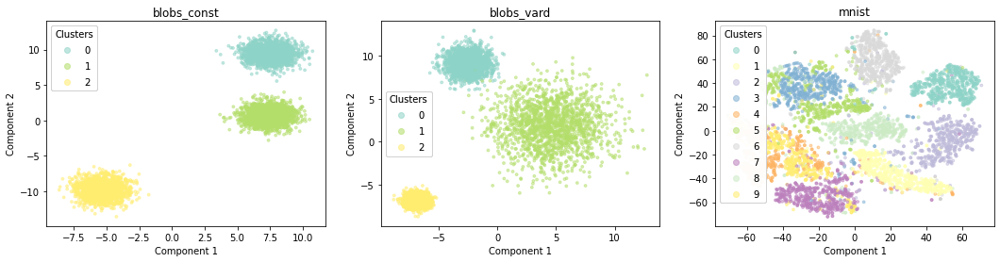

In [4]:
# # first, we must package a few datasets in the appropriate format

# # constants
# n_samples = 5000
# random_state = 42
# data_names = ['blobs_const', 'blobs_vard', 'mnist']

# # generate sklearn blob data
# data0 = datasets.make_blobs(n_samples=n_samples, random_state=8)
# data1 = datasets.make_blobs(n_samples=n_samples, cluster_std=[1.0, 2.5, 0.5],  random_state=random_state)

# # let's also include some MNIST data for high dimensionality!
# (train_X, train_y), (test_X, test_y) = mnist.load_data()
# train_X = np.reshape(train_X, (train_X.shape[0], train_X.shape[1]*train_X.shape[2]))

# # we only want n_samples points from mnist for now
# idx = np.random.choice(range(train_X.shape[0]), n_samples)
# data2 = [train_X[idx,:], train_y[idx,]]

# # save in expected format
# datas = [data0, data1, data2]

# for dataset,data_name in zip(datas, data_names):
#     os.mkdir(os.path.join(DATA_PATH, data_name))
#     np.save(os.path.join(DATA_PATH, data_name, 'data_to_cluster.npy'), dataset[0])
#     np.save(os.path.join(DATA_PATH, data_name, 'true_labels.npy'), dataset[1])

# # visualize data
# fig,axs = plt.subplots(1, len(datas), figsize=(len(datas)*6,4))
# for dataset,data_name,ax in zip(datas, data_names, axs.ravel()):

#     # get embedding
#     if dataset[0].shape[1] > 2:
#         embedding = compare.get_embedding(DATA_PATH, data_name)
#     else:
#         embedding = dataset[0]
    
#     # make subplot
#     compare.scatter_helper(ax, embedding, dataset[1], data_name, subscript=None)

# plt.show()

In [8]:
# setup arguments for comparison
data_path_list = ['blobs_const', 'blobs_vard', 'mnist']

method_list = ['SpectralClustering', 'AgglomerativeClustering', 'DBSCAN', 'KMeans']
params = [  {'n_clusters' : (2,15,13)}, 
            {'n_clusters' : (2,15,13)},
            {'eps' : (1.0, 2.0, 10), 'min_samples' : (1,6,5)},
            {'n_clusters' : (2,15,13)}
        ]


DATASET: blobs_const, METHOD: SpectralClustering


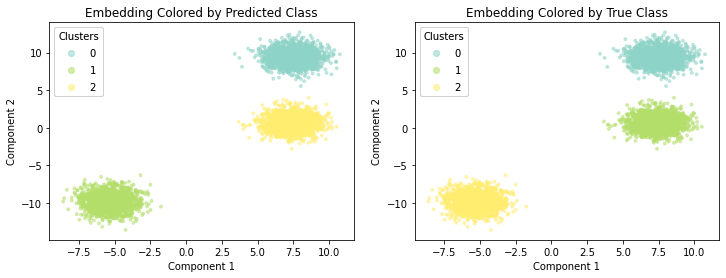

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_const, METHOD: AgglomerativeClustering


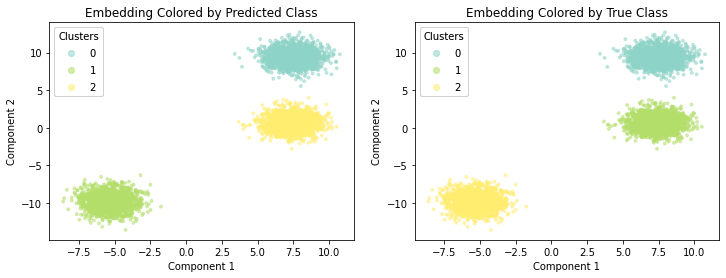

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_const, METHOD: DBSCAN


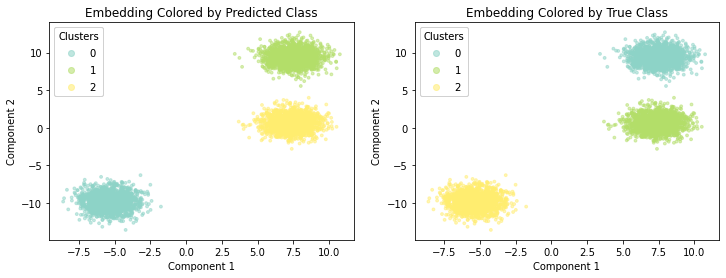

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'eps': 1.2222222222222223, 'min_samples': 1}

DATASET: blobs_const, METHOD: KMeans


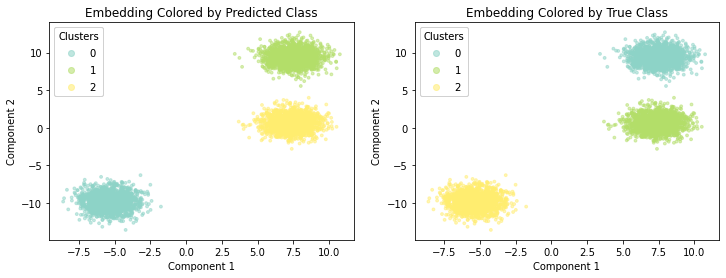

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: SpectralClustering


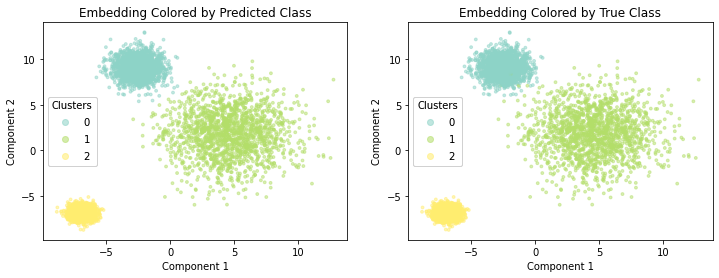

best ground-truth score: 0.9888614893925656
best cluster-goodness score: 0.7721580733555093
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: AgglomerativeClustering


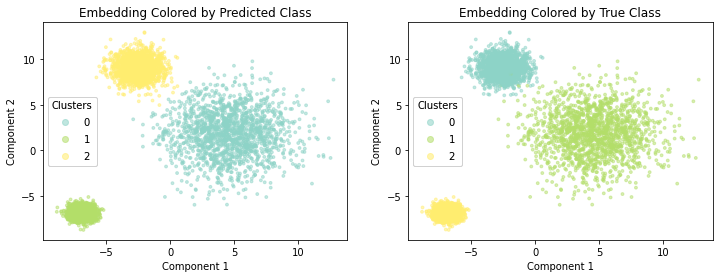

best ground-truth score: 0.9879385587647908
best cluster-goodness score: 0.7722708134333838
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: DBSCAN


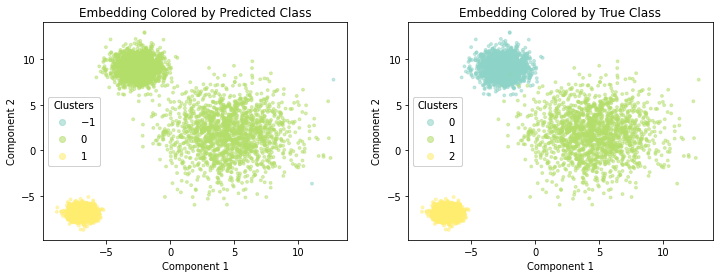

best ground-truth score: 0.7323710206780718
best cluster-goodness score: 0.5824657483303859
best params {'eps': 1.7777777777777777, 'min_samples': 2}

DATASET: blobs_vard, METHOD: KMeans


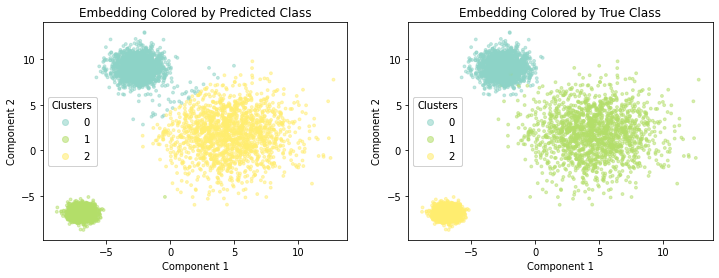

best ground-truth score: 0.9626614579748362
best cluster-goodness score: 0.7731938855536118
best params {'n_clusters': 3}

DATASET: mnist, METHOD: SpectralClustering


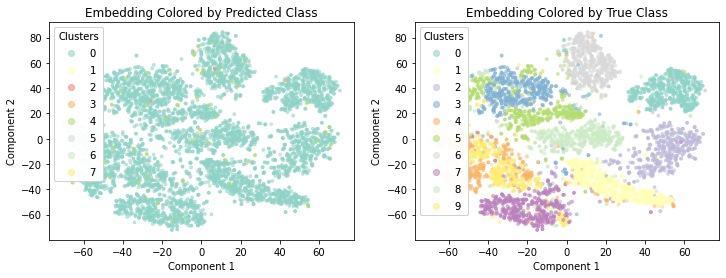

best ground-truth score: 0.002817341018515673
best cluster-goodness score: -0.10613128303296118
best params {'n_clusters': 8}

DATASET: mnist, METHOD: AgglomerativeClustering


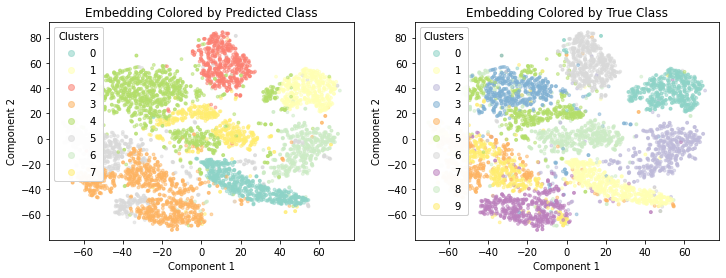

best ground-truth score: 0.646427977778409
best cluster-goodness score: 0.05019470916941169
best params {'n_clusters': 8}

DATASET: mnist, METHOD: DBSCAN


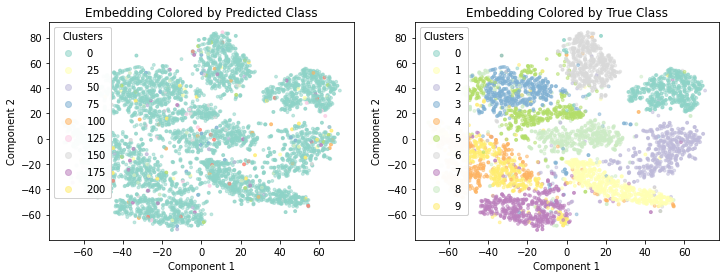

best ground-truth score: 0.039518020458969905
best cluster-goodness score: -0.2675871897992691
best params {'eps': 1.0, 'min_samples': 2}

DATASET: mnist, METHOD: KMeans


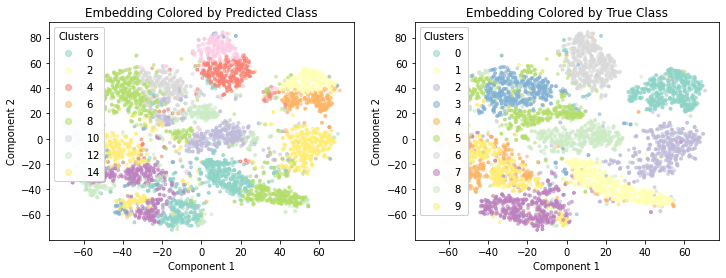

best ground-truth score: 0.5062331619458376
best cluster-goodness score: 0.06316246550855012
best params {'n_clusters': 15}


In [9]:
# run comparison
with warnings.catch_warnings(): # warnings from CFL make things messy right now
    warnings.simplefilter("ignore")
    compare.main(DATA_PATH, data_path_list, method_list, params, RESULTS_PATH)

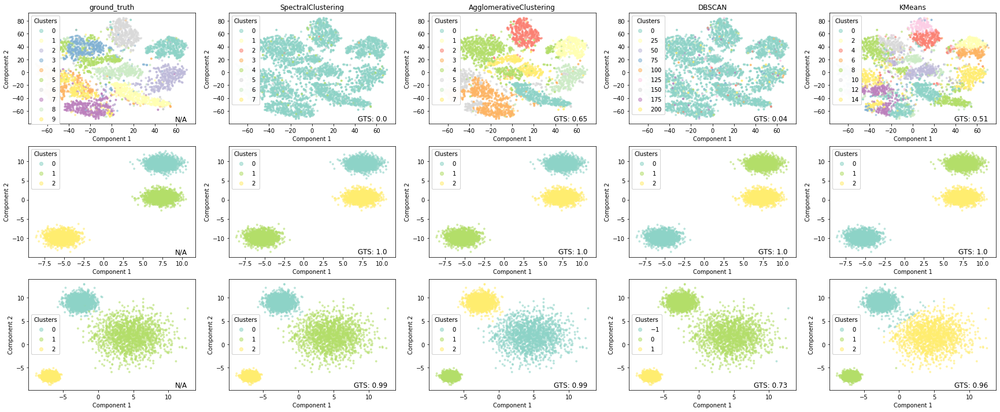

In [10]:
from importlib import reload
reload(compare)
compare.compare_scatter_plots(DATA_PATH, RESULTS_PATH, subfigsize=(6,4), fig_path=FIG_PATH)

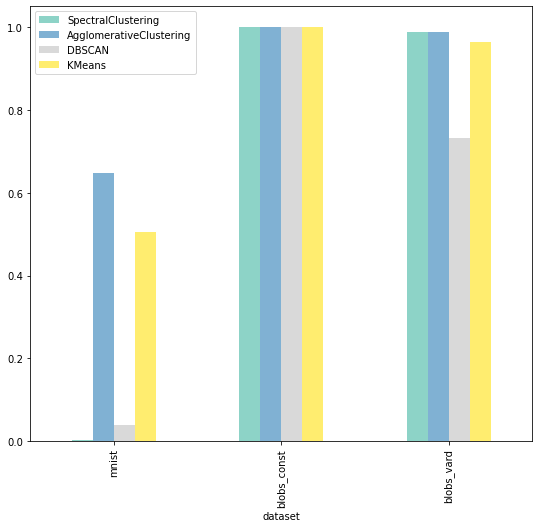

In [26]:
reload(compare)
compare.compare_best_gt_scores(RESULTS_PATH, fig_path=FIG_PATH)

In [ ]:
# TODO
- param search over strings (distance metrics)
- collect run times for each dataset/method
- run on cde output